In [1]:
cd /scratch/tsany/clim711/gfdl_spectral_code/t85barotropic

/scratch/tsany/clim711/gfdl_spectral_code/t85barotropic


In [2]:
ls

 00000000.logfile.000000.out   barotropic.nc    eddy_change_1/   eddy_change_6/
 00000000.time_stamp.out       barotropic.x*    eddy_change_2/   eddy_change_7/
 INPUT/                        data_table       eddy_change_3/   eddy_change_8/
'Lat Profile.png'              diag_table       eddy_change_4/   input.nml
 RESTART/                      eddy_change_0/   eddy_change_5/   rr.png


In [3]:
# eddy_change_1 = 0.0
# eddy_change_2 = 5.0
# eddy_change_3 = 10.0
# default = 15.0
# eddy_change_4 = 20.0
# eddy_change_5 = 25.0
# eddy_change_0 = 30.0;
# Eddy_change_6 = 40.0

# Eddy_change_7 = 60.0
# eddy_change_8 = 90.0
# 9==default

`Question:` How does the latitude width of the initial vorticity disturbance ('eddy_width') in the barotropic atmosphere model influence the lifecycle and propagation characteristics of the Rossby waves?

`Hypothesis:` In the barotropic model, the Eddy Width plays a crucial role in determining the behavior of Rossby waves. A wider 'eddy_width' results in Rossby waves that have a longer lifespan and will move slowly. In contrast, narrower disturbances lead to shorter-lived and faster-moving Rossby waves. 

In [4]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import xarray as xr

import cartopy.crs as ccrs
import cartopy.feature as cf
from cartopy.util import add_cyclic_point
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize

In [5]:
eddy_changes = {}

for i in range(9):
    path = f'/scratch/tsany/clim711/gfdl_spectral_code/t85barotropic/eddy_change_{i}/'
    eddy_changes[f'eddy_change_{i}'] = xr.open_dataset(f'{path}barotropic.nc', decode_times=False)


In [6]:
# Reorganize 
ds_0 = eddy_changes['eddy_change_1']
ds_5 = eddy_changes['eddy_change_2']
ds_10 = eddy_changes['eddy_change_3']
ds_15 = xr.open_dataset('/scratch/tsany/clim711/gfdl_spectral_code/t85barotropic/barotropic.nc', decode_times=False)
ds_20 = eddy_changes['eddy_change_4']
ds_25 = eddy_changes['eddy_change_5']
ds_30 = eddy_changes['eddy_change_0']
ds_40 = eddy_changes['eddy_change_6']

ds_60 = eddy_changes['eddy_change_7']
ds_90 = eddy_changes['eddy_change_8']

In [7]:
# Reorganize
ds_20

<xarray.Dataset>
Dimensions:   (lon: 256, lonb: 257, lat: 128, latb: 129, time: 25)
Coordinates:
  * lon       (lon) float64 0.0 1.406 2.812 4.219 ... 354.4 355.8 357.2 358.6
  * lonb      (lonb) float64 -0.7031 0.7031 2.109 3.516 ... 356.5 357.9 359.3
  * lat       (lat) float64 -88.93 -87.54 -86.14 -84.74 ... 86.14 87.54 88.93
  * latb      (latb) float64 -90.0 -88.28 -86.87 -85.46 ... 86.87 88.28 90.0
  * time      (time) float64 1.0 2.0 3.0 4.0 5.0 ... 21.0 22.0 23.0 24.0 25.0
Data variables:
    ucomp     (time, lat, lon) float32 ...
    vcomp     (time, lat, lon) float32 ...
    vor       (time, lat, lon) float32 ...
    pv        (time, lat, lon) float32 ...
    stream    (time, lat, lon) float32 ...
    trs       (time, lat, lon) float32 ...
    tr        (time, lat, lon) float32 ...
    eddy_vor  (time, lat, lon) float32 ...
    delta_u   (time, lat, lon) float32 ...
Attributes:
    filename:   barotropic.nc
    title:      t85barotropic
    grid_type:  regular
    grid_tile:  N/A

In [8]:
# List of your datasets
datasets = [ds_0, ds_5, ds_10, ds_15, ds_20, ds_25, ds_30, ds_40]
eddy_widths = ['0', '5', '10', '15', '20', '25', '30', '40']

# Calculate the maximum absolute value across all datasets for symmetry
max_abs_value = max([max(abs(ds['vor'].min()), abs(ds['vor'].max())) for ds in datasets])

# Set vmin and vmax for a symmetrical colorbar around zero
vmin, vmax = -max_abs_value, max_abs_value
print(vmin.values, vmax.values)

-5.102340946905315e-05 5.102340946905315e-05


In [9]:
# Plot wind data
ds = ds_15 


In [10]:
def plot_vorticity_for_time_step(time_step):
    vmin, vmax = -5e-5, 5e-5
    eddy_widths = ['0', '5', '10', '15', '20', '25', '30', '40']
    
    # Seting up the figure and axes
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 6.4), dpi=300, subplot_kw={'projection': ccrs.PlateCarree()})
    axes = axes.flatten()
    
    quivers = []
    # Ploting each dataset
    for i, ds in enumerate(datasets):
        data = ds['vor'].isel(time=time_step)
        ucomp = ds['ucomp'].isel(time=time_step)
        vcomp = ds['vcomp'].isel(time=time_step)

        # Add cyclic points for continuity in the plot
        data_cyclic, lon_cyclic = add_cyclic_point(data, coord=ds['lon'])
        ucomp_cyclic, _ = add_cyclic_point(ucomp, coord=ds['lon'])
        vcomp_cyclic, _ = add_cyclic_point(vcomp, coord=ds['lon'])

        # Create meshgrid for quiver
        lon2d, lat2d = np.meshgrid(lon_cyclic, ds['lat'])
        
        # Subsample data for quiver to avoid overcrowding
        quiver_stride = 10
        lon2d_sub = lon2d[::quiver_stride, ::quiver_stride]
        lat2d_sub = lat2d[::quiver_stride, ::quiver_stride]
        ucomp_sub = ucomp_cyclic[::quiver_stride, ::quiver_stride]
        vcomp_sub = vcomp_cyclic[::quiver_stride, ::quiver_stride]

        # Plot the vorticity
        pcm = axes[i].contourf(lon_cyclic, ds['lat'], data_cyclic, transform=ccrs.PlateCarree(), vmin=vmin, vmax=vmax, cmap='bwr', extend='both')
        axes[i].add_feature(cf.COASTLINE)
        axes[i].set_title(f'Vorticity (Eddy Width {eddy_widths[i]})', fontsize=16)
        
        # Quiver plot for wind vectors
        Q = axes[i].quiver(lon2d_sub, lat2d_sub, ucomp_sub, vcomp_sub, transform=ccrs.PlateCarree(), color='black', scale=400)
        quivers.append(Q)
        
        # Gridlines
        gl = axes[i].gridlines(draw_labels=True, linewidth=0)
        gl.top_labels = False
        gl.right_labels = False
        gl.bottom_labels = i >= 4  
        gl.left_labels = i % 4 == 0  

    # Adjust the layout
    plt.tight_layout()
    axes[3].quiverkey(quivers[7], X=0.85, Y=-0.25, U=15,
                      label='15 m/s', labelpos='E', coordinates='axes')
    
    # Create a ScalarMappable with the normalization and colormap for the colorbar
    norm = Normalize(vmin=vmin, vmax=vmax)
    sm = ScalarMappable(norm=norm, cmap='bwr')

    # Add a single colorbar for all subplots
    cbar_ax = fig.add_axes([0.1, 0.01, 0.8, 0.02])  # x-position, y-position, width, height
    cbar = fig.colorbar(sm, cax=cbar_ax, orientation='horizontal', label='Vorticity (1/s)')

    # Define the tick locations and labels
    ticks = np.linspace(vmin, vmax, 11)
    tick_labels = [f'{int(tick/1e-5)}' for tick in ticks]

    # Set the ticks and labels on the colorbar
    cbar.set_ticks(ticks)
    cbar.set_ticklabels(tick_labels)
    cbar.ax.text(1, -2.5, r'$\times 10^{-5}$', ha='center', va='center', transform=cbar.ax.transAxes)

    # plt.suptitle(f'Rossby Waves Patterns for Day {time_step+1} Across Different Eddy Widths in a Barotropic Model', fontsize=20, y=1.05)
    plt.savefig(f'/scratch/tsany/CLIM711/vor_wind_Day{time_step+1}', bbox_inches='tight')
    
    # Show the plot
    plt.show()

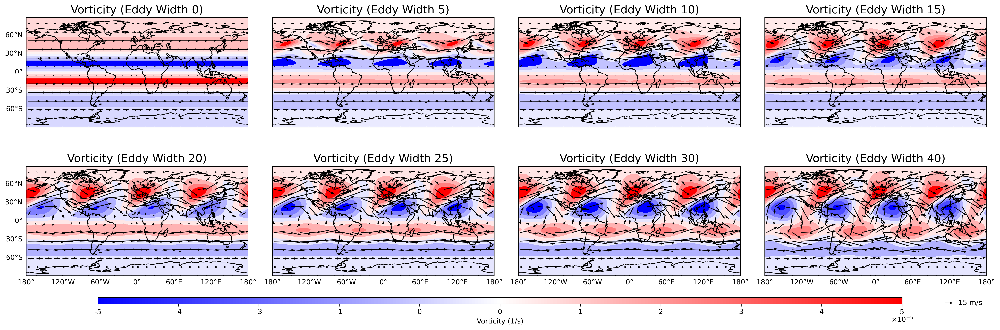

In [11]:
plot_vorticity_for_time_step(0)

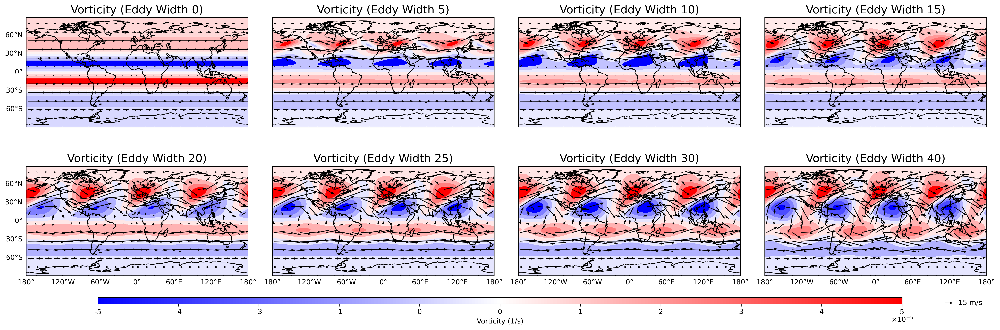

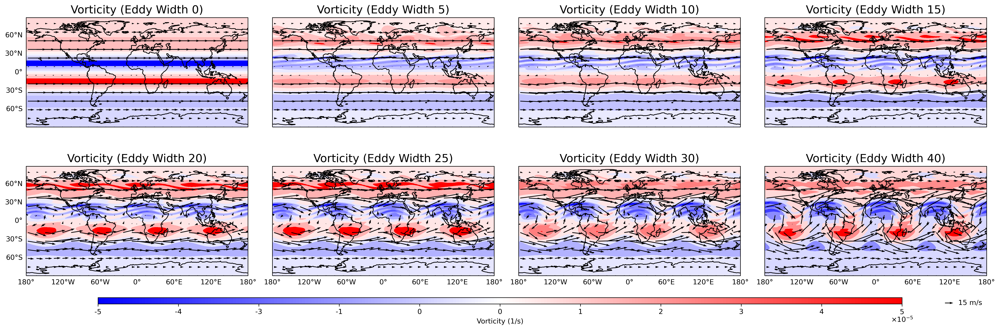

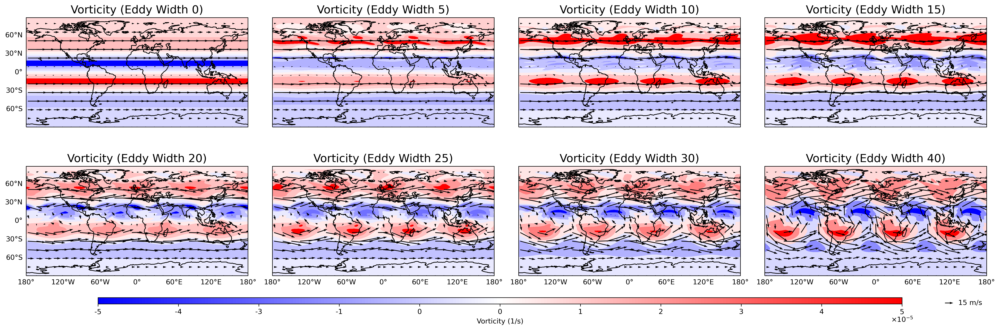

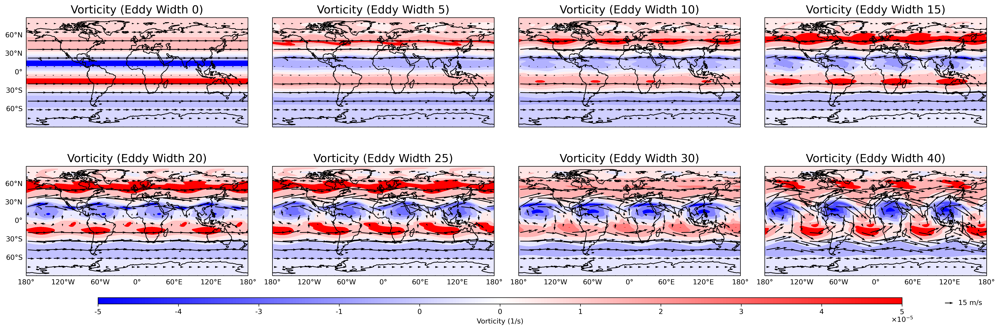

In [12]:
plot_vorticity_for_time_step(0)
plot_vorticity_for_time_step(9)
plot_vorticity_for_time_step(14)
plot_vorticity_for_time_step(24)


In [13]:
# List of your datasets
datasets = [ds_0, ds_5, ds_10, ds_15, ds_20, ds_25, ds_30, ds_40]
eddy_widths = ['0', '5', '10', '15', '20', '25', '30', '40']

wind_speed = np.sqrt(ds['ucomp']**2 + ds['vcomp']**2)
wmin = wind_speed.min()
wmax = wind_speed.max()

print(wmin.values, wmax.values)

0.05474889278411865 48.413658142089844


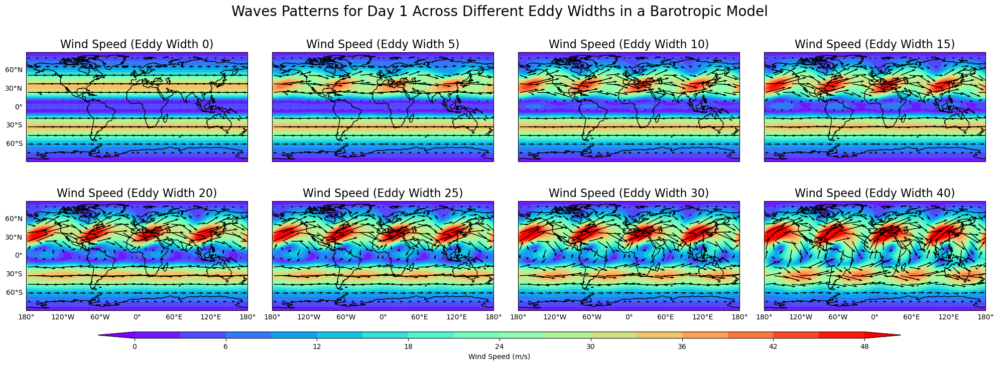

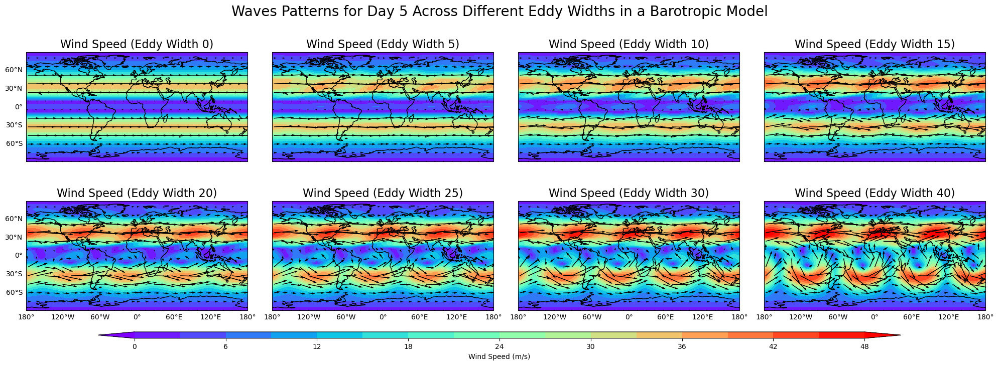

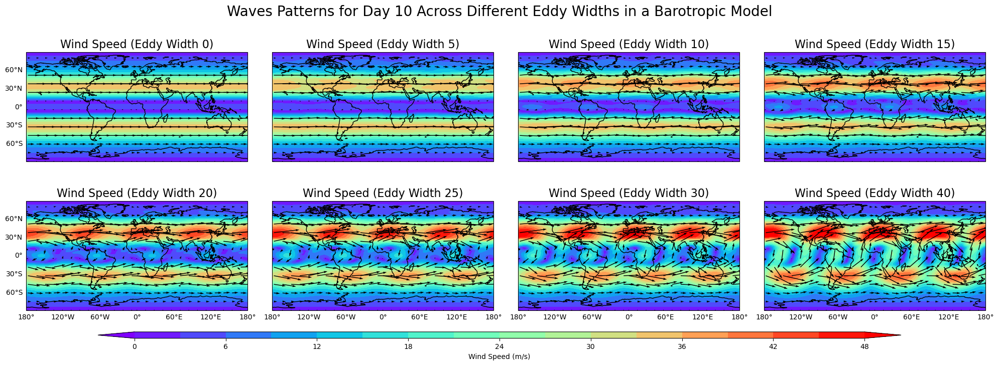

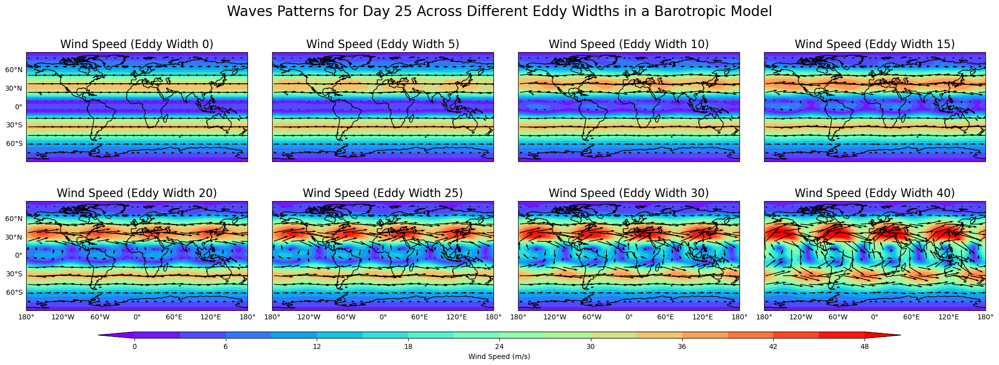

In [66]:
def plot_wind_for_time_step(time_step):
    # vmin, vmax = -5e-5, 5e-5
    clev = np.arange(0, 50, 3)
    eddy_widths = ['0', '5', '10', '15', '20', '25', '30', '40']
    
    # Seting up the figure and axes
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 6.4), subplot_kw={'projection': ccrs.PlateCarree()})
    axes = axes.flatten()
    
    # Ploting each dataset
    for i, ds in enumerate(datasets):
        data = ds['vor'].isel(time=time_step)
        ucomp = ds['ucomp'].isel(time=time_step)
        vcomp = ds['vcomp'].isel(time=time_step)
        wind_speed = np.sqrt(ds['ucomp']**2 + ds['vcomp']**2).isel(time=time_step)
        
        # Add cyclic points for continuity in the plot
        data_cyclic, lon_cyclic = add_cyclic_point(wind_speed, coord=ds['lon'])
        ucomp_cyclic, _ = add_cyclic_point(ucomp, coord=ds['lon'])
        vcomp_cyclic, _ = add_cyclic_point(vcomp, coord=ds['lon'])

        # Create meshgrid for quiver
        lon2d, lat2d = np.meshgrid(lon_cyclic, ds['lat'])
        
        # Subsample data for quiver to avoid overcrowding
        quiver_stride = 10
        lon2d_sub = lon2d[::quiver_stride, ::quiver_stride]
        lat2d_sub = lat2d[::quiver_stride, ::quiver_stride]
        ucomp_sub = ucomp_cyclic[::quiver_stride, ::quiver_stride]
        vcomp_sub = vcomp_cyclic[::quiver_stride, ::quiver_stride]

        # Plot the vorticity
        pcm = axes[i].contourf(lon_cyclic, ds['lat'], data_cyclic, clev, transform=ccrs.PlateCarree(), cmap='rainbow', extend='both')
        axes[i].add_feature(cf.COASTLINE)
        axes[i].set_title(f'Wind Speed (Eddy Width {eddy_widths[i]})', fontsize=16)
        
        # Quiver plot for wind vectors
        axes[i].quiver(lon2d_sub, lat2d_sub, ucomp_sub, vcomp_sub, transform=ccrs.PlateCarree(), color='black', scale=400)

        # Gridlines
        gl = axes[i].gridlines(draw_labels=True, linewidth=0)
        gl.top_labels = False
        gl.right_labels = False
        gl.bottom_labels = i >= 4  
        gl.left_labels = i % 4 == 0  

    # Adjust the layout
    plt.tight_layout()

    # Create a ScalarMappable with the normalization and colormap for the colorbar
    # norm = Normalize(vmin=vmin, vmax=vmax)
    # sm = ScalarMappable(norm=norm, cmap='bwr')

    # Add a single colorbar for all subplots
    cbar_ax = fig.add_axes([0.1, 0.01, 0.8, 0.02])  # x-position, y-position, width, height
    cbar = fig.colorbar(pcm, cax=cbar_ax, orientation='horizontal', label='Wind Speed (m/s)')

#     # Define the tick locations and labels
#     ticks = np.linspace(vmin, vmax, 11)
#     tick_labels = [f'{int(tick/1e-5)}' for tick in ticks]

#     # Set the ticks and labels on the colorbar
#     cbar.set_ticks(ticks)
#     cbar.set_ticklabels(tick_labels)
#     cbar.ax.text(1, -2.5, r'$\times 10^{-5}$', ha='center', va='center', transform=cbar.ax.transAxes)
    

    # Add the super title for the entire figure
    plt.suptitle(f'Day {time_step+1}', fontsize=16, y=1.05)

    # Show the plot
    plt.show()
plot_wind_for_time_step(0)
plot_wind_for_time_step(4)
plot_wind_for_time_step(9)
plot_wind_for_time_step(24)

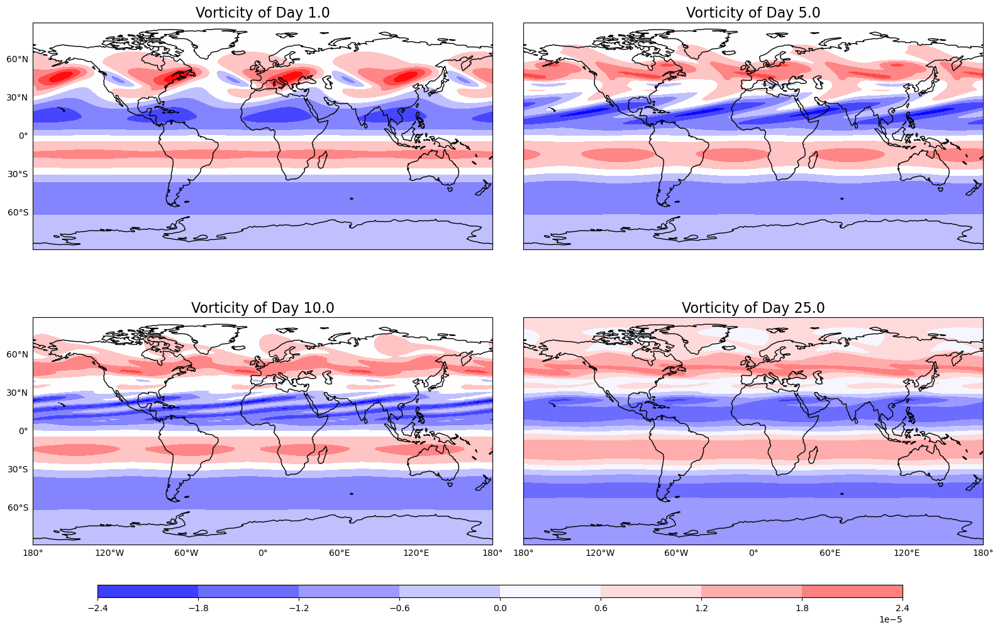

In [20]:
ds =ds_5
# Determine common colorbar limits
vmin = ds.vor.min()
vmax = ds.vor.max()

fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(16, 10),
                         subplot_kw={'projection': ccrs.PlateCarree()})

# Flatten the axes array for easy iteration
axes = axes.flatten()

days = [1,5,10,25]
for i, ax in enumerate(axes):    
    data = ds.vor[days[i]-1,:,:]
    data, lons = add_cyclic_point(data, coord=data['lon'])
    pcm = ax.contourf(lons, ds.vor.lat, data, transform=ccrs.PlateCarree(),
                      vmin=vmin, vmax=vmax, cmap='bwr') 
    ax.add_feature(cf.COASTLINE)
    ax.set_title(f"Vorticity of Day {ds.vor[days[i]-1,:,:].time.values}", fontsize=16)
    
    # Gridlines
    gl = ax.gridlines(draw_labels=True, linewidth=0)
    gl.top_labels = False
    gl.right_labels = False
    gl.bottom_labels = i > 1  # Only label the bottom row 
    gl.left_labels = i % 2 == 0  # Only label the left-most column

# Adjust the layout
plt.tight_layout()

# Add a single colorbar
cbar_ax = fig.add_axes([0.1, 0, 0.8, 0.02])  # x-position, y-position, width, height
fig.colorbar(pcm, cax=cbar_ax, orientation='horizontal')
# plt.savefig('rr.png')
plt.show()

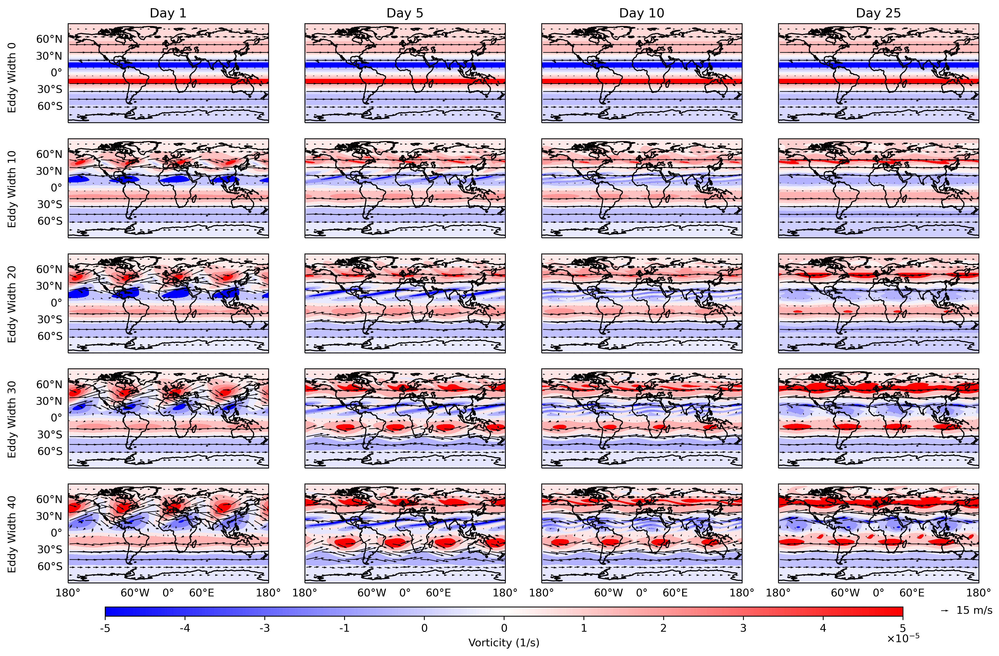

In [58]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cf
import numpy as np
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize
from cartopy.util import add_cyclic_point
import xarray as xr

# Assuming 'datasets' is a list of xarray Dataset objects for each eddy width
datasets = [ds_0, ds_5, ds_10, ds_15, ds_20, ds_25, ds_30, ds_40]
eddy_widths = [0, 10, 20, 30, 40]
days = [0, 4, 9, 24] #days = days+1

# Define the function to plot vorticity and wind vectors
def plot_vorticity_and_wind(time_step, eddy_widths, datasets):
    vmin, vmax = -5e-5, 5e-5
    
    # Setting up the figure and axes
    fig, axes = plt.subplots(nrows=len(eddy_widths), ncols=len(days), figsize=(13, 8), dpi=300, subplot_kw={'projection': ccrs.PlateCarree()})
    
    for i, eddy_width in enumerate(eddy_widths):
        for j, day in enumerate(days):
            ax = axes[i, j]
            ds = datasets[i]
            data = ds['vor'].isel(time=day)
            ucomp = ds['ucomp'].isel(time=day)
            vcomp = ds['vcomp'].isel(time=day)

            # Add cyclic points for continuity in the plot
            data_cyclic, lon_cyclic = add_cyclic_point(data, coord=ds['lon'])
            ucomp_cyclic, _ = add_cyclic_point(ucomp, coord=ds['lon'])
            vcomp_cyclic, _ = add_cyclic_point(vcomp, coord=ds['lon'])

            # Create meshgrid for quiver
            lon2d, lat2d = np.meshgrid(lon_cyclic, ds['lat'])
            
            # Subsample data for quiver to avoid overcrowding
            quiver_stride = 10
            lon2d_sub = lon2d[::quiver_stride, ::quiver_stride]
            lat2d_sub = lat2d[::quiver_stride, ::quiver_stride]
            ucomp_sub = ucomp_cyclic[::quiver_stride, ::quiver_stride]
            vcomp_sub = vcomp_cyclic[::quiver_stride, ::quiver_stride]

            # Plot the vorcreate code structure for reading and traing cliticity
            pcm = ax.contourf(lon_cyclic, ds['lat'], data_cyclic, transform=ccrs.PlateCarree(), vmin=vmin, vmax=vmax, cmap='bwr', extend='both')
            ax.add_feature(cf.COASTLINE)
            
            # Quiver plot for wind vectors
            Q = ax.quiver(lon2d_sub, lat2d_sub, ucomp_sub, vcomp_sub, transform=ccrs.PlateCarree(), color='black', scale=400)

            # Gridlines
            gl = ax.gridlines(draw_labels=True, linewidth=0)
            gl.top_labels = False
            gl.right_labels = False
            gl.bottom_labels = i == len(eddy_widths) - 1  # Label only the bottom row
            gl.left_labels = j == 0  # Label only the first column
            
            # Set title for the subplots in the top row
            if i == 0:
                ax.set_title(f'Day {day+1}')
            
            # Set title for the subplots in the first column
            if j == 0:
                ax.text(-0.25, 0.1, f'Eddy Width {eddy_width}', va='bottom', ha='right', rotation='vertical', transform=ax.transAxes)

    # Adjust the layout
    plt.tight_layout()
    axes[3, 3].quiverkey(Q, X=0.85, Y=-0.28, U=15,
                      label='15 m/s', labelpos='E', coordinates='axes')
    
     # Create a ScalarMappable with the normalization and colormap for the colorbar
    norm = Normalize(vmin=vmin, vmax=vmax)
    sm = ScalarMappable(norm=norm, cmap='bwr')

    # Add a single colorbar for all subplots
    cbar_ax = fig.add_axes([0.1, -0.01, 0.8, 0.015])  # x-position, y-position, width, height
    cbar = fig.colorbar(sm, cax=cbar_ax, orientation='horizontal', label='Vorticity (1/s)')

    # Define the tick locations and labels
    ticks = np.linspace(vmin, vmax, 11)
    tick_labels = [f'{int(tick/1e-5)}' for tick in ticks]

    # Set the ticks and labels on the colorbar
    cbar.set_ticks(ticks)
    cbar.set_ticklabels(tick_labels)
    cbar.ax.text(1, -2.5, r'$\times 10^{-5}$', ha='center', va='center', transform=cbar.ax.transAxes)
    plt.savefig(f'/scratch/tsany/CLIM711/vor_wind_all_day.png', bbox_inches='tight')
    # Show the plot
    plt.show()

# Call the function with the specified days and eddy widths
plot_vorticity_and_wind(days, eddy_widths, datasets)


In [ ]:
# Assuming 'datasets' is a list of xarray Dataset objects for each eddy width
datasets = [ds_0, ds_10, ds_20, ds_30, ds_40]
eddy_widths = [0, 10, 20, 30, 40]
days = [0, 4, 9, 24] #days = days+1
clev = np.arange(0, 50, 3)

# Define the function to plot vorticity and wind vectors
def plot_windSpeed_and_wind(time_step, eddy_widths, datasets):
    vmin, vmax = -5e-5, 5e-5
    projection = ccrs.PlateCarree()
    # Setting up the figure and axes
    fig, axes = plt.subplots(nrows=len(eddy_widths), ncols=len(days), figsize=(13, 8), dpi=300, subplot_kw={'projection': ccrs.PlateCarree()})
    for i, ds in enumerate(datasets):  # Assuming datasets is in the same order as eddy_widths
        for j, day in enumerate(days):

            ax = axes[i, j]
            
            # Select the data for a specific time step and eddy width.
            # Make sure to select the proper dimensions (e.g., time and level if applicable).
            ucomp = ds.ucomp.isel(time=day)
            vcomp = ds.vcomp.isel(time=day)
            wind_speed = np.sqrt(ucomp**2 + vcomp**2)

            # Add cyclic point for continuity in the plot
            wind_speed_cyclic, lon_cyclic = add_cyclic_point(wind_speed, coord=ds.lon)
                    # Create meshgrid for quiver
                    # Add cyclic points for continuity in the plot
            data_cyclic, lon_cyclic = add_cyclic_point(wind_speed, coord=ds['lon'])
            ucomp_cyclic, _ = add_cyclic_point(ucomp, coord=ds['lon'])
            vcomp_cyclic, _ = add_cyclic_point(vcomp, coord=ds['lon'])

            # Create meshgrid for quiver
            lon2d, lat2d = np.meshgrid(lon_cyclic, ds['lat'])

            # Subsample data for quiver to avoid overcrowding
            quiver_stride = 10
            lon2d_sub = lon2d[::quiver_stride, ::quiver_stride]
            lat2d_sub = lat2d[::quiver_stride, ::quiver_stride]
            ucomp_sub = ucomp_cyclic[::quiver_stride, ::quiver_stride]
            vcomp_sub = vcomp_cyclic[::quiver_stride, ::quiver_stride]
            # Plot the wind speed
            pcm = ax.contourf(lon_cyclic, ds.lat, wind_speed_cyclic, clev, transform=projection, 
                              cmap='rainbow')
    
            ax.add_feature(cf.COASTLINE)
            
            # Quiver plot for wind vectors
            Q = ax.quiver(lon2d_sub, lat2d_sub, ucomp_sub, vcomp_sub, transform=ccrs.PlateCarree(), color='black', scale=400)

            # Gridlines
            gl = ax.gridlines(draw_labels=True, linewidth=0)
            gl.top_labels = False
            gl.right_labels = False
            gl.bottom_labels = i == len(eddy_widths) - 1  # Label only the bottom row
            gl.left_labels = j == 0  # Label only the first column
            
            # Set title for the subplots in the top row
            if i == 0:
                ax.set_title(f'Day {day+1}')
            
            # Set title for the subplots in the first column
            if j == 0:
                ax.text(-0.25, 0.1, f'Eddy Width {eddy_widths[i]}', va='bottom', ha='right', rotation='vertical', transform=ax.transAxes)

#             # Only for the first column
#             if j == 0:
#                 ax.set_ylabel(f'Eddy Width {eddy_widths[i]}')
            
            
#             # Only for the first row
#             if i == 0:
#                 ax.set_title(f'Day {day+1}')
    # Adjust the layout
    plt.tight_layout()
    axes[3, 3].quiverkey(Q, X=0.85, Y=-0.28, U=15,
                      label='15 m/s', labelpos='E', coordinates='axes')
    

    
    # Add a single colorbar for all subplots
    cbar_ax = fig.add_axes([0.1, -0.01, 0.8, 0.015])  # x-position, y-position, width, height
    cbar = fig.colorbar(pcm, cax=cbar_ax, orientation='horizontal', label='Wind Speed (m/s)')
    cbar.ax.text(1, -2.5, r'$\times 10^{-5}$', ha='center', va='center', transform=cbar.ax.transAxes)

    # plt.savefig(f'/scratch/tsany/CLIM711/windspeed_wind_all_day.png', bbox_inches='tight')
    # Show the plot
    plt.show()

# Call the function with the specified days and eddy widths
plot_windSpeed_and_wind(days, eddy_widths, datasets)